In [2]:

import tensorflow as tf
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix


from PIL import Image
import splitfolders

tfk = tf.keras
tfkl = tf.keras.layers
print(tf.__version__)



# Random seed for reproducibility
seed = 42

random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)


import warnings
import logging

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)
tf.get_logger().setLevel('INFO')
tf.autograph.set_verbosity(0)

tf.get_logger().setLevel(logging.ERROR)
tf.get_logger().setLevel('ERROR')
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)


print(os.chdir('/Users/franciscosanchez/Downloads/ANNDL PROJECT 1 4/'))
splitfolders.ratio("training_data_final", output="output", seed=seed, ratio=(.75, .15, .10), group_prefix=None, move=False) # default values

# Dataset folders 
dataset_dir = 'output'


#Plot example images from dataset
labels = ["Species1",   #0
          "Species2",   #1
          "Species3",   #2
          "Species4",   #3
          "Species5",   #4
          "Species6",   #5
          "Species7",   #6
          "Species8" ]  #7

num_row = 4
num_col = 3

rgb_weights = [0.2989, 0.5870, 0.1140]








2022-11-25 23:47:12.120268: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


2.10.0
None


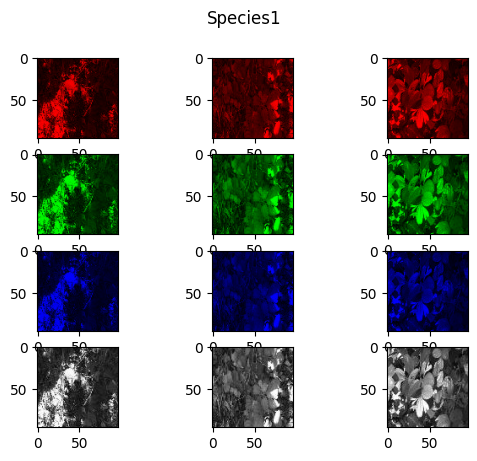

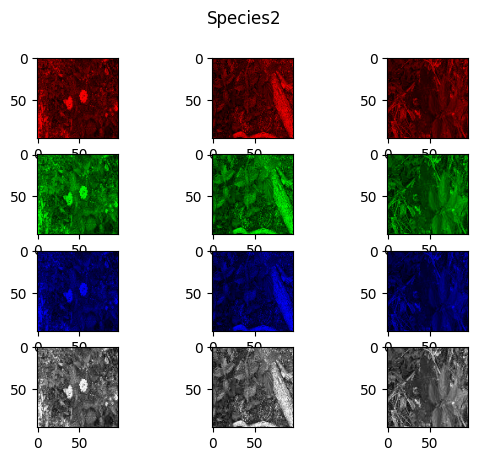

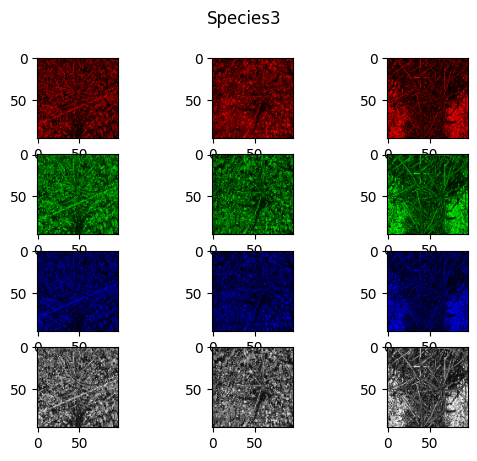

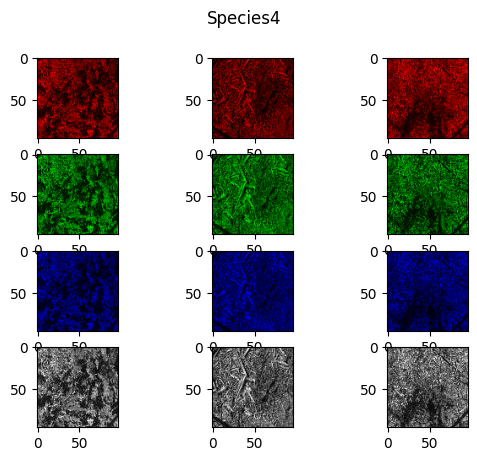

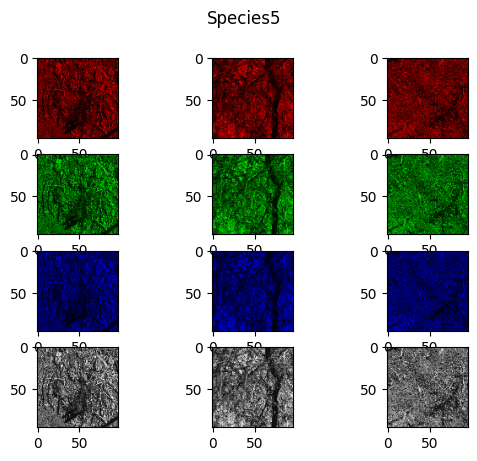

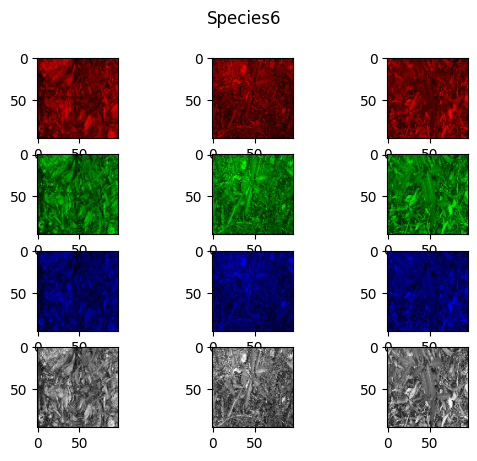

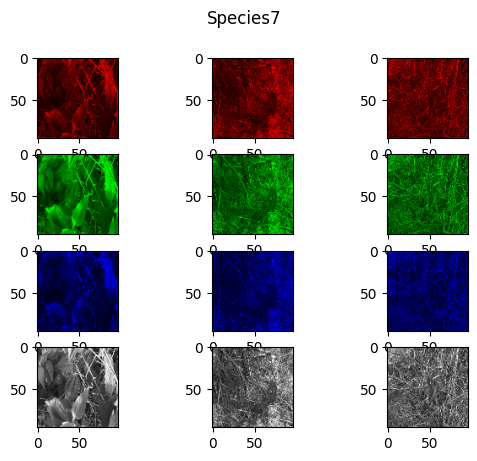

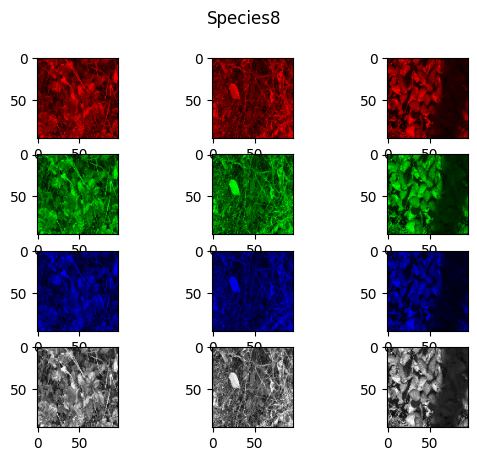

In [2]:
#Plot Different channels on all classes
for j in range(8):
  fig,axes = plt.subplots(num_row, num_col)
  for i in range(num_col):
        class_imgs = next(os.walk('training_data_final/{}/'.format(labels[j])))[2]
        len(class_imgs)
        class_img = class_imgs[i]
        img = Image.open('training_data_final/{}/{}'.format(labels[j], class_img))
        img = np.array(img)
        for k in range(num_row):
            ax = axes[k, i]
            if k < 3:
              pic = np.zeros(img.shape, dtype="uint8")
              pic[ :, :, k] = img[ :, :, k] 
              ax.imshow(np.array(pic))
            else:
              pic = np.dot(img[...,:3], rgb_weights)
              ax.imshow(pic, cmap=plt.get_cmap("gray"))
  plt.suptitle(labels[j])
  plt.draw()

plt.show()





508

In [4]:
img.shape

(96, 96, 3)

In [36]:
act.shape


(96, 96, 3, 186, 8)

Class: 0
Class: 1
Class: 2
Class: 3
Class: 4
Class: 5
Class: 6
Class: 7


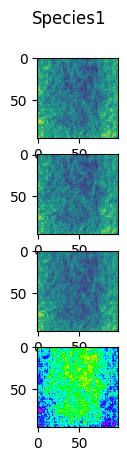

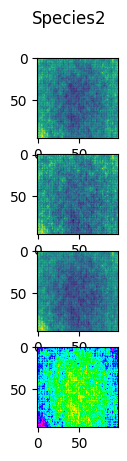

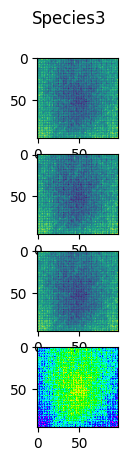

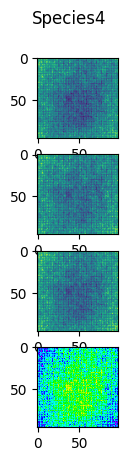

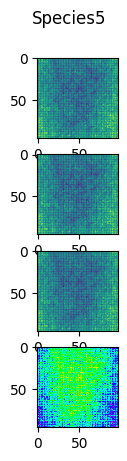

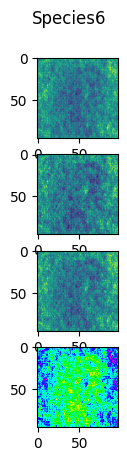

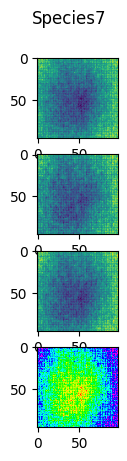

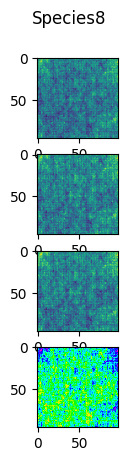

In [38]:
# Calcualte variance among all classes to see how ifnormation id distributed, on 3 channels plus graysscale 
num_row = 4
num_col = 1

rgb_weights = [0.2989, 0.5870, 0.1140]



for j in range(8):
  fig,axes = plt.subplots(num_row, num_col)
  print("Class: "+str(j))
  for i in range(num_col):
        class_imgs = next(os.walk('training_data_final/{}/'.format(labels[j])))[2]

        class_img = class_imgs[i]
        img = Image.open('training_data_final/{}/{}'.format(labels[j], class_img))
        img = np.array(img)
        act = np.zeros((img.shape+(len(class_imgs),)+(len(labels),)),dtype="uint8")

        for l in range(len(class_imgs)):
            act[:,:,:,l,j] = np.array(Image.open('training_data_final/{}/{}'.format(labels[j], class_imgs[l])))
            vact = np.var(act[:,:,:,:,j],3) 
        for k in range(num_row):
            ax = axes[k]
            if k < 3:
              pic = np.zeros(vact.shape, dtype="uint8")
              ax.imshow((vact[ :, :, k]),cmap=plt.get_cmap("hsv"))
            else:
              pic = np.dot(vact[...,:3], rgb_weights)
              ax.imshow(pic, cmap=plt.get_cmap("hsv"))
  plt.suptitle(labels[j])
  plt.draw()

plt.show()






In [ ]:
arr2 = np.var(act,3) 

In [ ]:
arr2.shape

In [ ]:
shape(act)

In [82]:

act.shape

(96, 96, 3, 508)

Class: 0
Class: 1
Class: 2
Class: 3
Class: 4
Class: 5
Class: 6
Class: 7


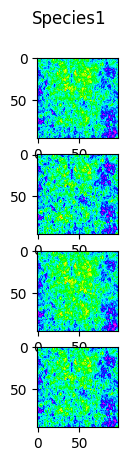

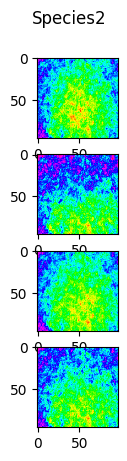

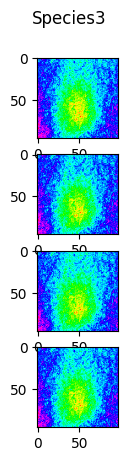

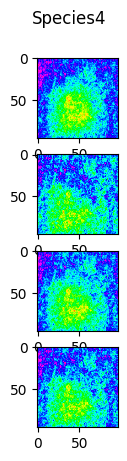

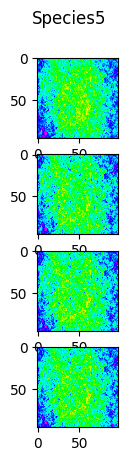

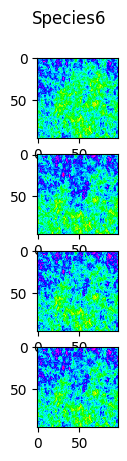

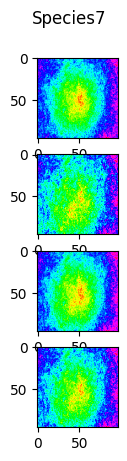

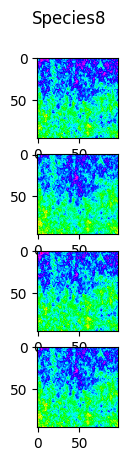

In [3]:
num_row = 4# Now mean is calcualted for RGB + grayscale
num_col = 1

rgb_weights = [0.2989, 0.5870, 0.1140]

for j in range(8):
  fig,axes = plt.subplots(num_row, num_col)
  print("Class: "+str(j))
  for i in range(num_col):
        class_imgs = next(os.walk('training_data_final/{}/'.format(labels[j])))[2]

        class_img = class_imgs[i]
        img = Image.open('training_data_final/{}/{}'.format(labels[j], class_img))
        img = np.array(img)
        act = np.zeros((img.shape+(len(class_imgs),)),dtype="uint8")

        for l in range(len(class_imgs)):
            act[:,:,:,l] = np.array(Image.open('training_data_final/{}/{}'.format(labels[j], class_imgs[l])))
        vact = np.mean(act,3) 
        for k in range(num_row):
            ax = axes[k]
            if k < 3:
              pic = np.zeros(vact.shape, dtype="uint8")
              ax.imshow((vact[ :, :, k]),cmap=plt.get_cmap("hsv"))
            else:
              pic = np.dot(vact[...,:3], rgb_weights)
              ax.imshow(pic, cmap=plt.get_cmap("hsv"))
  plt.suptitle(labels[j])
  plt.draw()


plt.show()






In [67]:
f=np.array(0,ndmin=5)

In [72]:
f.shape

(1, 1, 1, 1, 2)

In [71]:
f=np.array(ndmin=5)

In [80]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import ndimage
import image

def plot(data, title):
    plot.i += 1
    plt.subplot(2,2,plot.i)
    plt.imshow(data)
    plt.gray()
    plt.title(title)
plot.i = 0

# Load the data...
im = Image.open('lena.png')
data = np.array(im, dtype=float)
plot(data, 'Original')

# A very simple and very narrow highpass filter
kernel = np.array([[-1, -1, -1],
                   [-1,  8, -1],
                   [-1, -1, -1]])
highpass_3x3 = ndimage.convolve(data, kernel)
plot(highpass_3x3, 'Simple 3x3 Highpass')

# A slightly "wider", but sill very simple highpass filter 
kernel = np.array([[-1, -1, -1, -1, -1],
                   [-1,  1,  2,  1, -1],
                   [-1,  2,  4,  2, -1],
                   [-1,  1,  2,  1, -1],
                   [-1, -1, -1, -1, -1]])
highpass_5x5 = ndimage.convolve(data, kernel)
plot(highpass_5x5, 'Simple 5x5 Highpass')

# Another way of making a highpass filter is to simply subtract a lowpass
# filtered image from the original. Here, we'll use a simple gaussian filter
# to "blur" (i.e. a lowpass filter) the original.
lowpass = ndimage.gaussian_filter(data, 3)
gauss_highpass = data - lowpass
plot(gauss_highpass, r'Gaussian Highpass, $\sigma = 3 pixels$')

plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'lena.png'

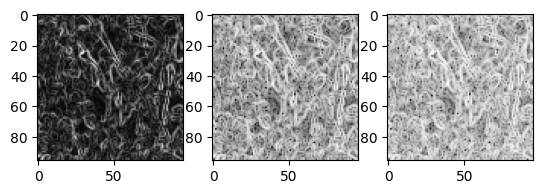

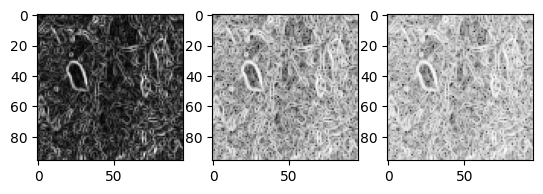

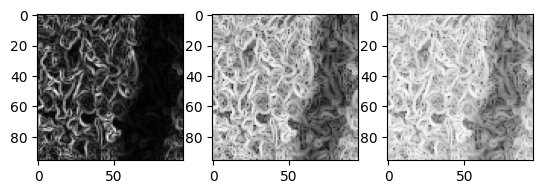

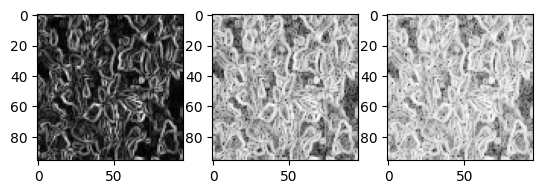

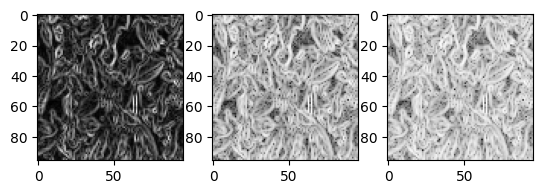

...

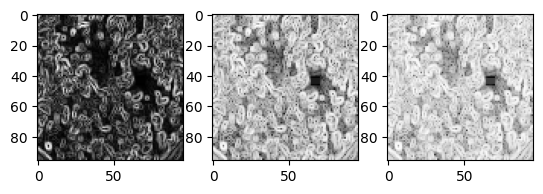

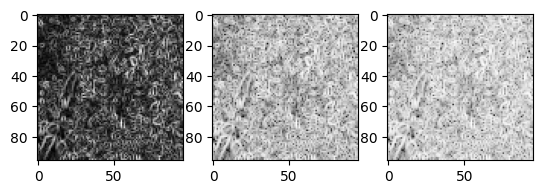

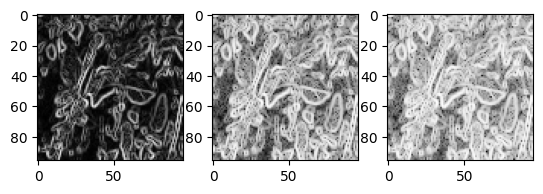

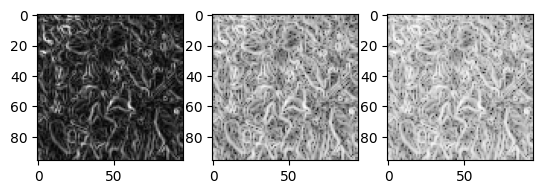

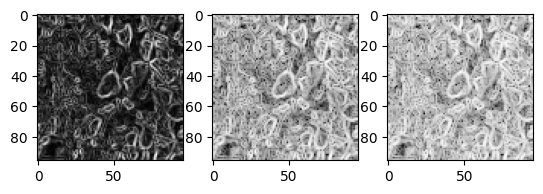

In [294]:
#Highlight with Sobel Functions blurred transitions
from skimage import filters,exposure
import numpy as np
import matplotlib.pyplot as plt

from scipy.signal import convolve2d as conv2

from skimage import color, data, restoration

for i in range(100):
    fig,axes = plt.subplots(1, 3)
    
    #astro = act[:,:,:,i]
    astro = exposure.adjust_gamma(act[:,:,:,i],.9)
    astro = np.dot(astro[...,:3], rgb_weights)
    

    # Restore Image using Richardson-Lucy algorithm
    deconvolved = filters.sobel(astro)
    #deconvolved_RL = np.asarray(deconvolved_RL)
    ax = axes[0]
    imgplot = ax.imshow(deconvolved,cmap=plt.get_cmap("gray"))
    ax = axes[1]
    imgplot = ax.imshow((np.log(deconvolved+1)),cmap=plt.get_cmap("gray"))
    ax = axes[2]
    imgplot = ax.imshow((exposure.adjust_gamma(np.log(1+deconvolved),.6)),cmap=plt.get_cmap("gray"))
    plt.show()

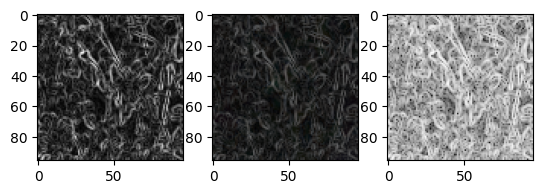

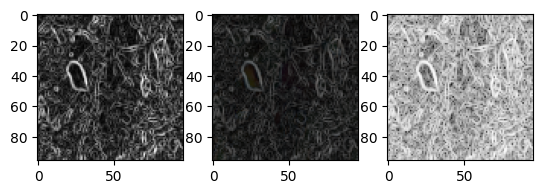

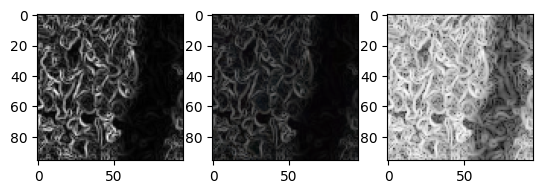

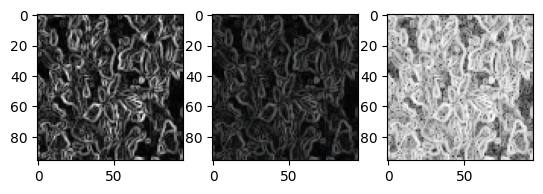

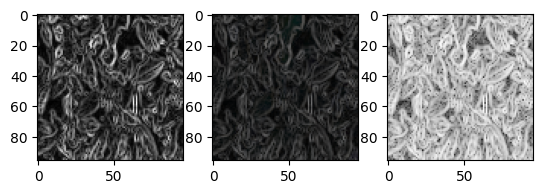

...

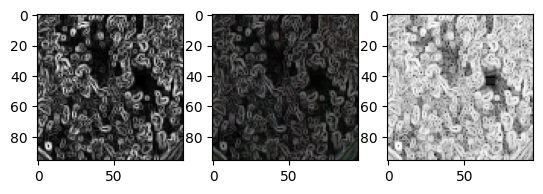

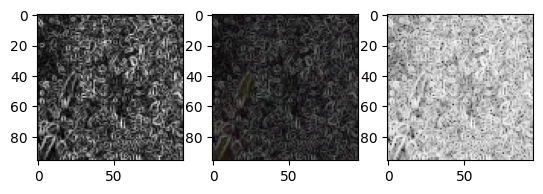

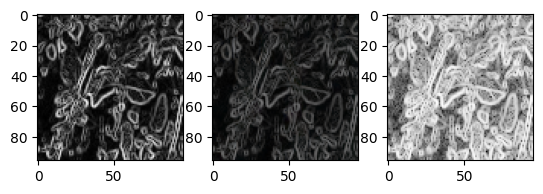

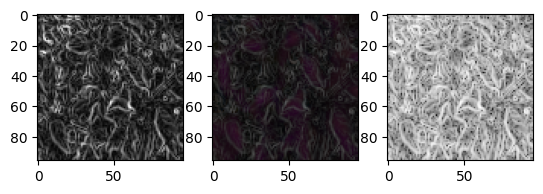

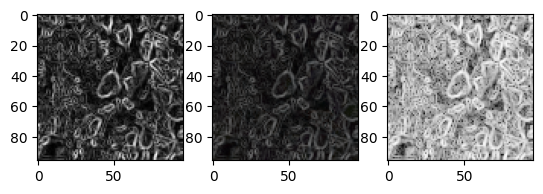

In [312]:
# Get sharpenned images with filtering and exposure fucntions
from skimage import filters,exposure
import numpy as np
import matplotlib.pyplot as plt

from scipy.signal import convolve2d as conv2

from skimage import color, data, restoration

for i in range(100):
    fig,axes = plt.subplots(1, 3)
    
    astro = act[:,:,:,i]
    astro1 = exposure.adjust_gamma(act[:,:,:,i],.9)
    astro = np.dot(astro[...,:3], rgb_weights)
    

    # Restore Image using Richardson-Lucy algorithm
    deconvolved = filters.sobel(astro)
    deconvolved1 = filters.sobel(astro1)
    #deconvolved_RL = np.asarray(deconvolved_RL)
    ax = axes[0]
    imgplot = ax.imshow(deconvolved,cmap=plt.get_cmap("gray"))
    ax = axes[1]
    #imgplot = ax.imshow((np.log(deconvolved+1)),cmap=plt.get_cmap("gray"))
    imgplot = ax.imshow(exposure.adjust_gamma(np.log(deconvolved1+1),.9),cmap=plt.get_cmap("gray"))
    ax = axes[2]
    imgplot = ax.imshow((exposure.adjust_gamma(np.log(1+deconvolved),.9)),cmap=plt.get_cmap("gray"))
    plt.show()

In [87]:
figure.imshow(act(:,:,:,1))

SyntaxError: invalid syntax (270965448.py, line 1)

In [118]:
a=1
type(deconvolved_RL)

tuple

In [226]:
(np.log(deconvolved+1)).min()

0.39157884056347625

In [404]:
#Load dat on Image gen to see if its working properly 
import numpy as np
import os
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix
import visualkeras
import numpy as np
from sklearn.utils.class_weight import compute_class_weight


from PIL import Image, ImageFont
import splitfolders
import os
import tensorflow as tf
import numpy as np
import random
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from sklearn.metrics import confusion_matrix

tfk = tf.keras
tfkl = tf.keras.layers
print(tf.__version__)



# Random seed for reproducibility
seed = 42

random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)


import warnings
import logging

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)
tf.get_logger().setLevel('INFO')
tf.autograph.set_verbosity(0)

tf.get_logger().setLevel(logging.ERROR)
tf.get_logger().setLevel('ERROR')
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)


print(os.chdir('/Users/franciscosanchez/Downloads/ANNDL PROJECT 1 4/'))
splitfolders.ratio("training_data_final", output="output", seed=seed, ratio=(.75, .15, .10), group_prefix=None, move=False) # default values

# Dataset folders 
dataset_dir = 'output'

bias_initializer = tf.keras.initializers.HeNormal()


training_dir = os.path.join(dataset_dir,'train')
validation_dir = os.path.join(dataset_dir,'val')
test_dir = os.path.join(dataset_dir, 'test')
#training_dir = dataset_dir
training_dir
print(validation_dir)

# Images are divided into folders, one for each class. 
# If the images are organized in such a way, we can exploit the 
# ImageDataGenerator to read them from disk.
from tensorflow.keras.preprocessing.image import ImageDataGenerator




# Create an instance of ImageDataGenerator with NO Data Augmentation
noaug_train_data_gen = ImageDataGenerator(
                                            rescale=1/255.,
                                            featurewise_std_normalization=1,
                                            featurewise_center = 1,
                                            # zca_whitening=1
                                            ) 
noaug_train_gen = noaug_train_data_gen.flow_from_directory(directory=training_dir,
                                                           target_size=(96,96),
                                                           color_mode='rgb',
                                                           classes=None, # can be set to labels
                                                           class_mode='categorical',
                                                           batch_size=8,
                                                           shuffle=True,
                                                           seed=seed)


valid_data_gen = ImageDataGenerator(
                                            rescale=1/255.,
                                            featurewise_std_normalization=1,
                                            featurewise_center = 1,
                                            # zca_whitening=1
                                            )
valid_gen = valid_data_gen.flow_from_directory(directory=validation_dir,
                                               target_size=(96,96),
                                               color_mode='rgb',
                                               classes=None, # can be set to labels
                                               class_mode='categorical',
                                               batch_size=8,
                                               shuffle=True,
                                               seed=seed)


test_data_gen = ImageDataGenerator(
                                            rescale=1/255.,
                                            featurewise_std_normalization=1,
                                            featurewise_center = 1,
                                            preprocessing_function=exp1,
                                            # zca_whitening=1
                                            )
test_gen = test_data_gen.flow_from_directory(directory=test_dir,
                                             target_size=(96,96),
                                             classes=None, # can be set to labels
                                             class_mode='categorical',
                                             batch_size=1,
                                             color_mode="grayscale",
                                             shuffle=False,
                                             seed=seed)


aug_train_data_gen = ImageDataGenerator(
                                        featurewise_center = 1,
                                        # rotation_range=30,
                                        # height_shift_range=50,
                                        # width_shift_range=50,
                                        featurewise_std_normalization=1,
                                        # zoom_range=0.3,
                                        # horizontal_flip=True,
                                        # vertical_flip=True, 
                                        # fill_mode='reflect',
                                        rescale=1/255.
                                        ) # rescale value is multiplied to the image
aug_train_gen = aug_train_data_gen.flow_from_directory(directory=training_dir,
                                                       target_size=(96,96),
                                                       color_mode='rgb',
                                                       classes=None, # can be set to labels
                                                       class_mode='categorical',
                                                       batch_size=8,
                                                       shuffle=True,
                                                       seed=seed)


aug_valid_data_gen = ImageDataGenerator(
                                        featurewise_center = 1,
                                        # rotation_range=30,
                                        # height_shift_range=50,
                                        # width_shift_range=50,
                                        featurewise_std_normalization=1,
                                        # zoom_range=0.3,
                                        # horizontal_flip=True,
                                        # vertical_flip=True, 
                                        # fill_mode='reflect',
                                        rescale=1/255.
                                        )
aug_valid_gen = aug_valid_data_gen.flow_from_directory(directory=validation_dir,
                                                       target_size=(96,96),
                                                       color_mode='rgb',
                                                       classes=None, # can be set to labels
                                                       class_mode='categorical',
                                                       batch_size=8,
                                                       shuffle=True,
                                                       seed=seed)


aug_test_data_gen = ImageDataGenerator(
                                        featurewise_center = 1,
                                        # rotation_range=30,
                                        # height_shift_range=50,
                                        # width_shift_range=50,
                                        featurewise_std_normalization=1,
                                        # zoom_range=0.3,
                                        # horizontal_flip=True,
                                        # vertical_flip=True, 
                                        # fill_mode='reflect',
                                        rescale=1/255.
                                        )
aug_test_gen = aug_test_data_gen.flow_from_directory(directory=test_dir,
                                                       target_size=(96,96),
                                                       color_mode='rgb',
                                                       classes=None, # can be set to labels
                                                       class_mode='categorical',
                                                       batch_size=8,
                                                       shuffle=True,
                                                       seed=seed)



2.10.0
None
output/val
Found 2654 images belonging to 8 classes.
Found 527 images belonging to 8 classes.
Found 361 images belonging to 8 classes.
Found 2654 images belonging to 8 classes.
Found 527 images belonging to 8 classes.
Found 361 images belonging to 8 classes.


In [375]:
#Function to get 
from skimage import filters,exposure
import numpy as np
import matplotlib.pyplot as plt
from skimage import color, data, restoration

def exp12(img):
    
    rgb_weights = [0.2989, 0.5870, 0.1140]
    astro = np.dot(img[...,:3], rgb_weights)
    deconvolved = filters.sobel(astro)
    imgexp = exposure.adjust_gamma(np.log(1+deconvolved),.9)
    return imgexp
    #deconvolved_RL = np.asarray(deconvolved_RL)
    ax = axes[0]
    imgplot = ax.imshow(deconvolved,cmap=plt.get_cmap("gray"))
    ax = axes[1]
    #imgplot = ax.imshow((np.log(deconvolved+1)),cmap=plt.get_cmap("gray"))
    imgplot = ax.imshow(exposure.adjust_gamma(np.log(deconvolved1+1),.9),cmap=plt.get_cmap("gray"))
    ax = axes[2]
    imgplot = ax.imshow((exposure.adjust_gamma(np.log(1+deconvolved),.9)),cmap=plt.get_cmap("gray"))
    plt.show()

In [403]:
from skimage import filters,exposure
import numpy as np
import matplotlib.pyplot as plt
from skimage import color, data, restoration

def exp1(img):
    
    rgb_weights = [0.2989, 0.5870, 0.1140]
    #astro = np.dot(img[...,:3], rgb_weights)
    deconvolved = filters.sobel(img)
    imgexp = exposure.adjust_gamma(np.log(1+deconvolved),.9)
    np.reshape(imgexp, (96, 96,1))
    return imgexp

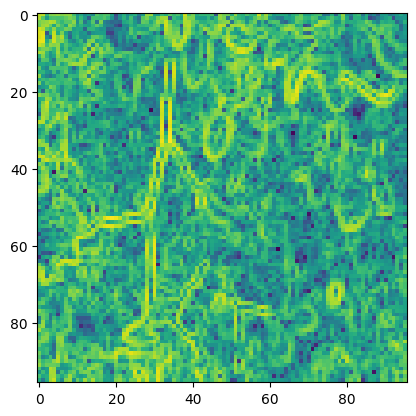

In [405]:
x=test_gen.next()
plt.imshow(np.squeeze((x[0])))

In [399]:
x[0].shape

(1, 96, 96, 3)

In [398]:
[len(a) for a in x]

[1, 1]

In [374]:
print(x)

(array([[[[0.5294118 , 0.4784314 , 0.5058824 ],
         [0.14901961, 0.09803922, 0.1254902 ],
         [0.29803923, 0.25490198, 0.27058825],
         ...,
         [0.2627451 , 0.23529413, 0.19607845],
         [0.20784315, 0.1764706 , 0.13333334],
         [0.20000002, 0.16862746, 0.11764707]],

        [[0.3921569 , 0.34117648, 0.36862746],
         [0.40000004, 0.3529412 , 0.36862746],
         [0.37647063, 0.33333334, 0.34901962],
         ...,
         [0.23137257, 0.20392159, 0.17254902],
         [0.2509804 , 0.227451  , 0.18039216],
         [0.21176472, 0.18823531, 0.13333334]],

        [[0.18039216, 0.13333334, 0.14901961],
         [0.48235297, 0.43529415, 0.4431373 ],
         [0.42352945, 0.38431376, 0.38823533],
         ...,
         [0.17254902, 0.15294118, 0.12941177],
         [0.25490198, 0.2392157 , 0.19607845],
         [0.17254902, 0.15686275, 0.10980393]],

        ...,

        [[0.04705883, 0.0509804 , 0.03137255],
         [0.3372549 , 0.34117648, 0.32156864

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


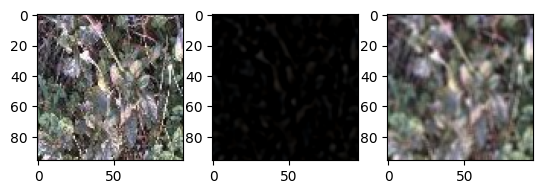

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


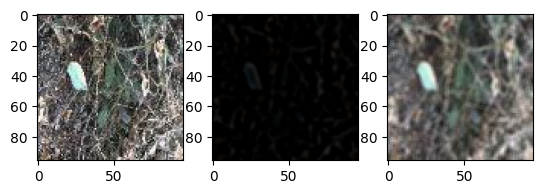

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


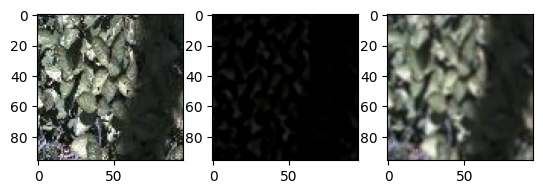

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


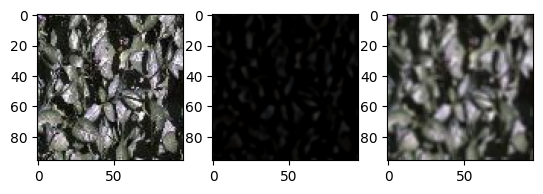

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


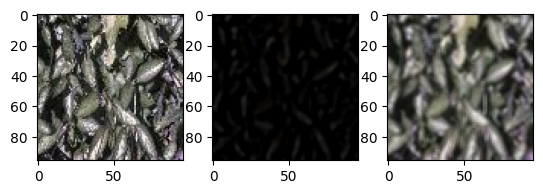

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


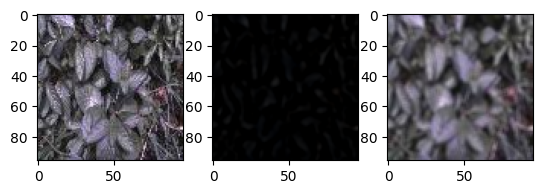

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


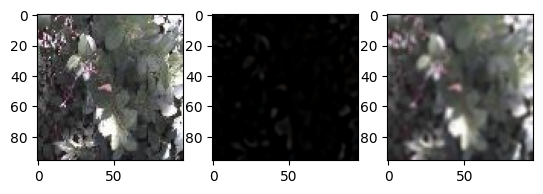

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


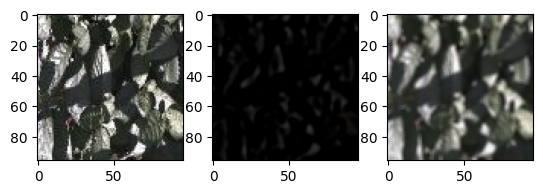

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


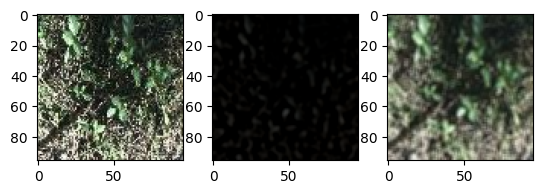

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


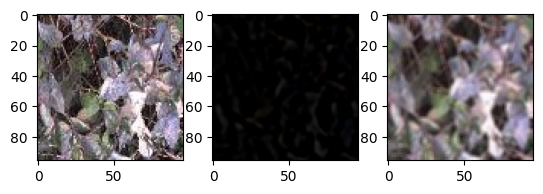

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


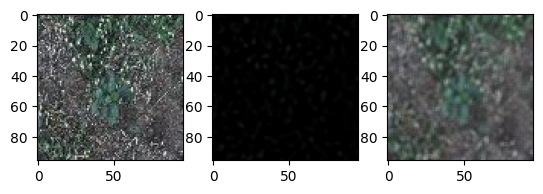

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


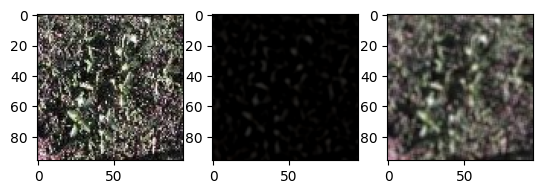

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


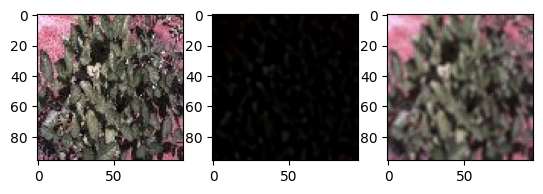

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


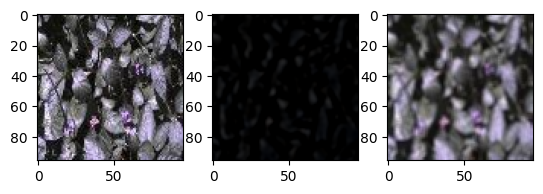

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


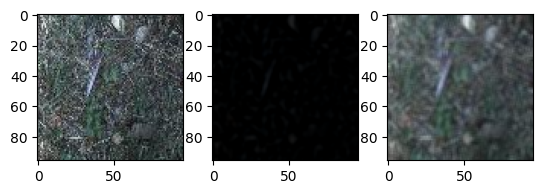

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


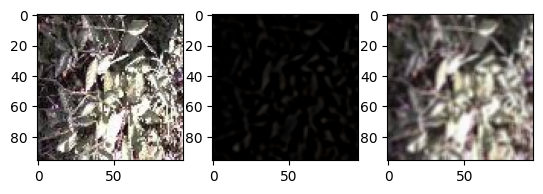

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


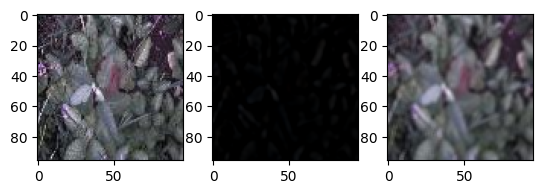

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


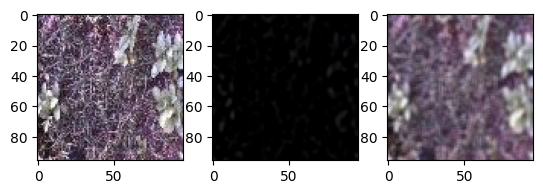

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


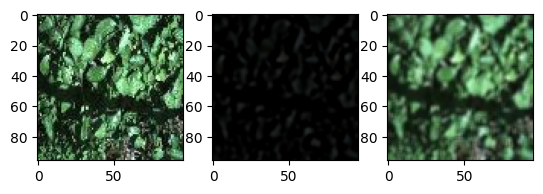

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


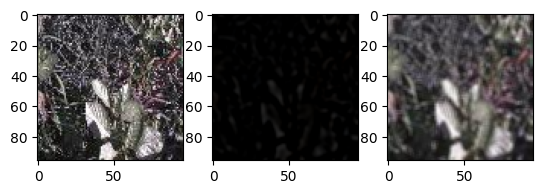

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


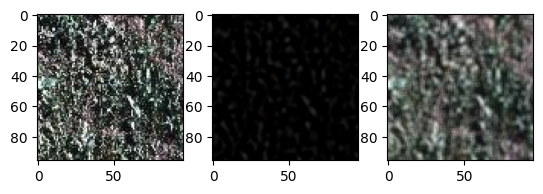

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


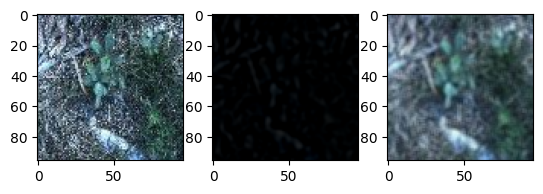

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


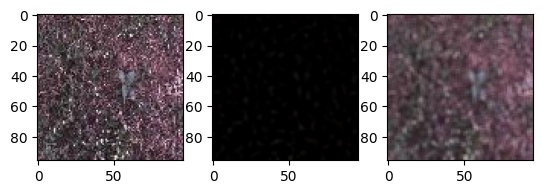

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


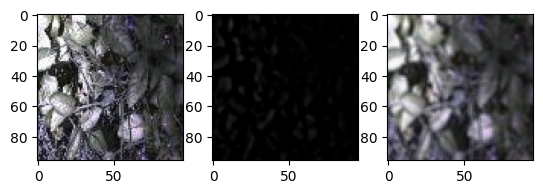

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


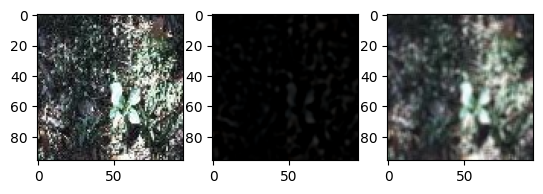

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


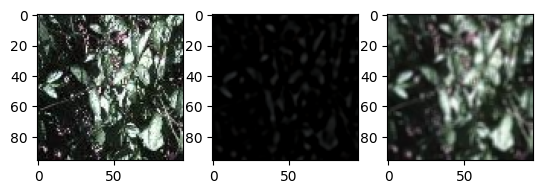

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


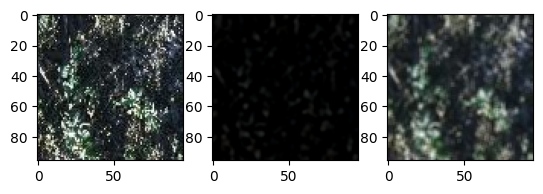

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


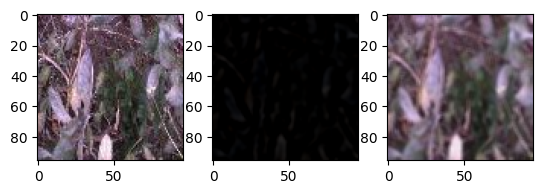

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


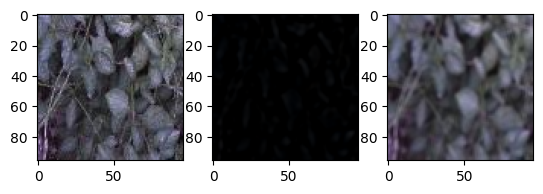

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


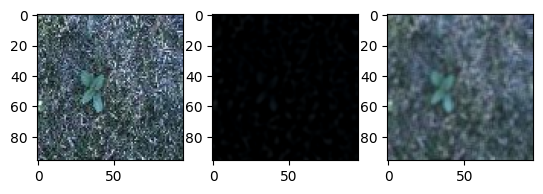

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


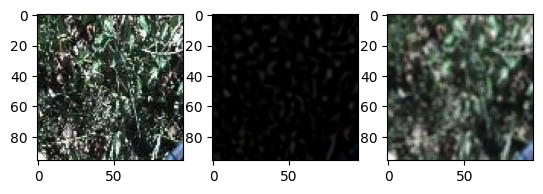

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


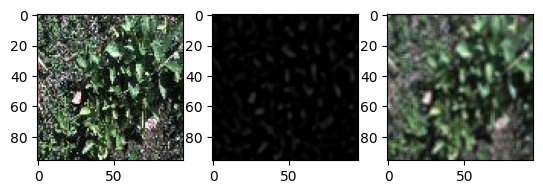

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


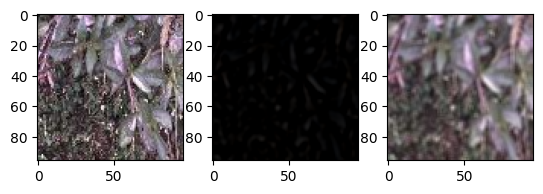

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


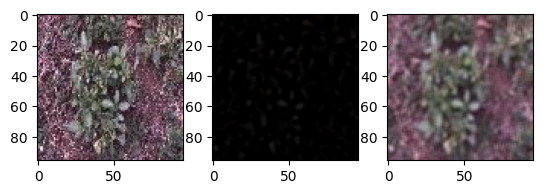

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


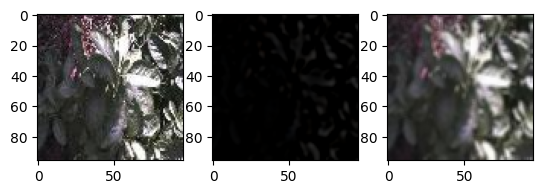

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


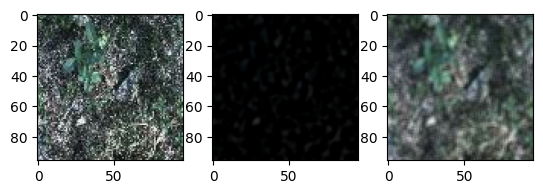

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


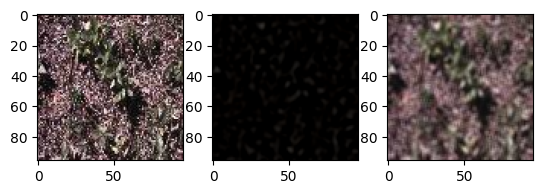

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


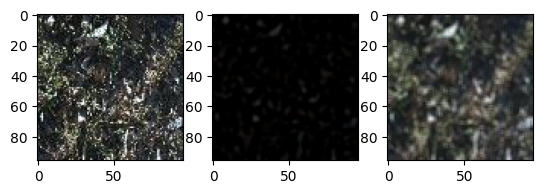

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


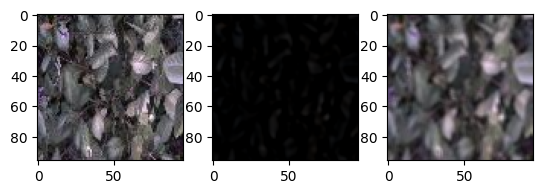

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


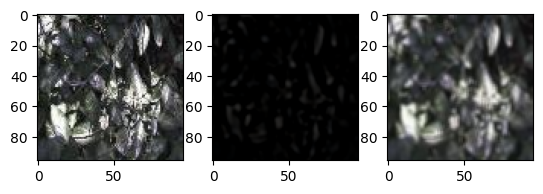

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


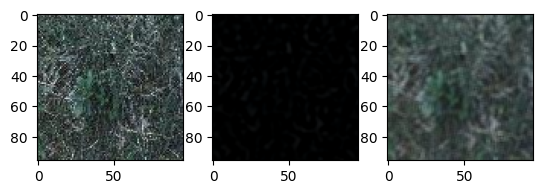

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


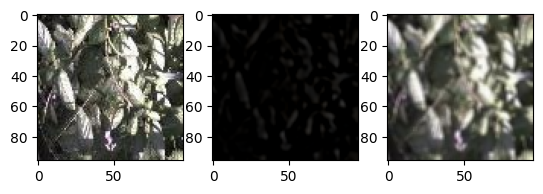

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


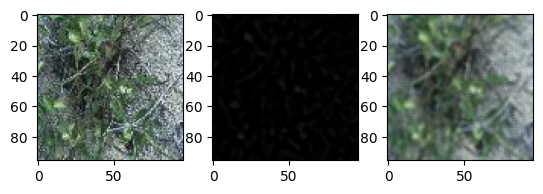

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


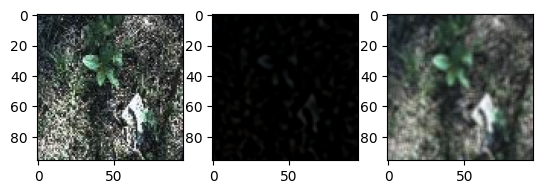

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


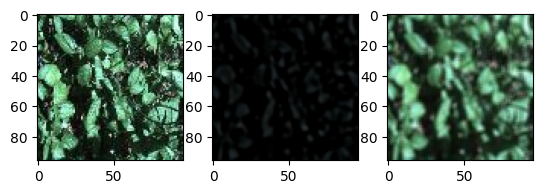

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KeyboardInterrupt: 

In [545]:
#High pass low pass experiment
import cv2
import numpy as np
import skimage 
from skimage import color, data, restoration
import cv2
kernel = np.array([[-1, -1, -1],
                   [-1, 9,-1],
                   [-1, -1, -1]])

kernellp = np.array([[1/9, 1/9, 1/9],
                   [1/9, 1/9, 1/9],
                   [1/9, 1/9, 1/9]])


for i in range(act.shape[3]):
    img = act[:,:,:,i]
    fig,axes = plt.subplots(1, 3)
    ax = axes[0]
    ax.imshow(img)
    ax = axes[1]
    filt_real = cv2.filter2D(src=img, ddepth=-1, kernel=kernellp)#lp
    imghp = cv2.filter2D(src=(img), ddepth=-1, kernel=kernel)

    ax.imshow(skimage.filters.difference_of_gaussians(img,1.5))
    ax = axes[2]
    imgplot = ax.imshow(((filt_real)))


    plt.show()

508

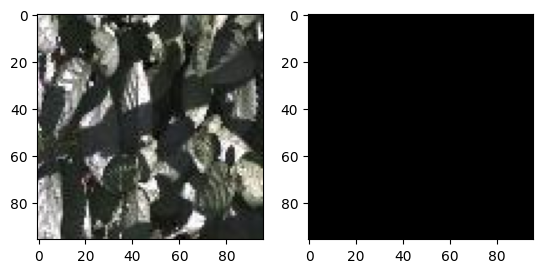

In [531]:
    fig,axes = plt.subplots(1, 2)
    ax = axes[0]
    ax.imshow(act[:,:,:,7])
    ax = axes[1]
    
    
    
    
    
    
    ax.imshow(cv2.normalize(act[:,:,:,7],cv2.NORM_MINMAX))
